<a href="https://colab.research.google.com/github/EugOT/CN-pr-MDD-snRNA-seq/blob/main/notebooks/load_snRNA-seq-MDD-for-concatenated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a> &nbsp; <a href="https://kaggle.com/kernels/welcome?src=https://raw.githubusercontent.com/EugOT/CN-pr-MDD-snRNA-seq/main/notebooks/load_snRNA-seq-MDD-for-concatenated.ipynb" target="_parent"><img src="https://kaggle.com/static/images/open-in-kaggle.svg" alt="Open in Kaggle"/></a>

# Load snRNA-seq MDD data for joint analysis

Initial analysis of single-nuclei RNA-seq data from prefrontal cortex (BA9) samples of individuals with major depressive disorder (MDD) and healthy controls.

 - males published in [Nagy et al. 2020](https://pubmed.ncbi.nlm.nih.gov/32341540/); raw data downloaded from [GEO](https://www.ncbi.nlm.nih.gov/bioproject/PRJNA602867); separate preprocessing is [deposited on GitHub](https://github.com/EugOT/PRJNA602867)
 - females published in [Maitra et al. 2023](https://pubmed.ncbi.nlm.nih.gov/37217515/); raw data downloaded from [GEO](https://www.ncbi.nlm.nih.gov/bioproject/PRJNA883411); separate preprocessing is [deposited on GitHub](https://github.com/EugOT/PRJNA883411)

In [1]:
# These packages are pre-installed on Google Colab, but are included here to facilitate running this notebook locally
!pip install --quiet matplotlib
!pip install --quiet scikit-learn
!pip install --quiet numpy
!pip install --quiet scipy
!pip install --quiet pacmap
!pip install --quiet leidenalg
!pip install --quiet sinfo
# snRNA-seq analysis
!pip install --quiet scanpy
!pip install --quiet omnipath
!pip install --quiet decoupler

In [2]:
!git clone https://github.com/EugOT/CN-pr-MDD-snRNA-seq.git
%cd /content/CN-pr-MDD-snRNA-seq/

fatal: destination path 'CN-pr-MDD-snRNA-seq' already exists and is not an empty directory.
/content/CN-pr-MDD-snRNA-seq


In [3]:
import os
import random
import pacmap
import numpy as np
import pandas as pd
import anndata as ad
import scanpy as sc
import decoupler as dc

import matplotlib
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
from anndata.experimental.multi_files import AnnCollection


matplotlib.rcParams["pdf.use14corefonts"] = True
matplotlib.rcParams["pdf.fonttype"] = 42
matplotlib.rcParams["ps.fonttype"] = 42
matplotlib.rcParams["font.family"] = "sans-serif"
matplotlib.rcParams["font.sans-serif"] = ["Helvetica"]
matplotlib.rcParams["figure.max_open_warning"] = 20000

reseed = 42
random.seed(reseed)
np.random.seed(reseed)

sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
# sc.settings.figdir = PLOTS_DIR
sc.settings.set_figure_params(
    dpi=180, dpi_save=600, vector_friendly=True, format="pdf", transparent=True
)
sc.settings.autoshow = True
sc.settings.autosave = False

In [4]:
samples_males = pd.read_csv("data/PRJNA602867.tsv", delimiter="\t")
samples_males = samples_males[["Run", "Condition", "LibraryName", "BioProject", "Sex", "NTotalCells"]]

samples_females = pd.read_csv("data/PRJNA883411.tsv", delimiter="\t")
samples_females = samples_females[["Run", "Condition", "LibraryName", "BioProject", "Sex", "NTotalCells"]]

In [5]:
males = sc.read_h5ad(
    "data/PRJNA602867-whole_dataset-fpr_0.001-clusters.h5ad"
)
males.obs['Run'] = males.obs['orig.ident']
males.obs = pd.merge(samples_males, males.obs, on="Run").set_index("cell_name", drop=False)
males.uns["name"] = "PRJNA602867"
sc.pp.filter_cells(males, min_genes=500)
sc.pp.filter_genes(males, min_cells=10)

females = sc.read_h5ad(
    "data/PRJNA883411-whole_dataset-fpr_0.001-clusters.h5ad"
)
females.obs['Run'] = females.obs['orig.ident']
females.obs = pd.merge(females.obs, samples_females, on="Run", how = "inner").set_index("cell_name", drop=False)
females.uns["name"] = "PRJNA883411"
sc.pp.filter_cells(females, min_genes=500)
sc.pp.filter_genes(females, min_cells=10)

In [6]:
males.obs = males.obs[[
    'cell_name',
    'background_fraction',
    'droplet_efficiency',
    'doublet_score',
    'nFeature_Diff',
    'nCount_Diff',
    'percent_mito',
    'percent_ribo',
    'percent_mito_ribo',
    'percent_hb',
    'log10GenesPerUMI',
    'k_tree',
    'Run',
    'Condition',
    'BioProject',
    'Sex',
    'n_genes']]

females.obs = females.obs[[
    'cell_name',
    'background_fraction',
    'droplet_efficiency',
    'doublet_score',
    'nFeature_Diff',
    'nCount_Diff',
    'percent_mito',
    'percent_ribo',
    'percent_mito_ribo',
    'percent_hb',
    'log10GenesPerUMI',
    'k_tree',
    'Run',
    'Condition',
    'BioProject',
    'Sex',
    'n_genes']]

In [7]:
sc.experimental.pp.highly_variable_genes(males, flavor="pearson_residuals", n_top_genes=5000)
sc.experimental.pp.highly_variable_genes(females, flavor="pearson_residuals", n_top_genes=5000)
males = males[:, males.var["highly_variable"]]
females = females[:, females.var["highly_variable"]]
males.obs["k_tree"] = males.obs["Sex"].astype(str) + "_" + males.obs["k_tree"].astype(str)
females.obs["k_tree"] = females.obs["Sex"].astype(str) + "_" + females.obs["k_tree"].astype(str)

<ipython-input-7-d761977e7785>:5: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  males.obs["k_tree"] = males.obs["Sex"].astype(str) + "_" + males.obs["k_tree"].astype(str)
<ipython-input-7-d761977e7785>:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  females.obs["k_tree"] = females.obs["Sex"].astype(str) + "_" + females.obs["k_tree"].astype(str)


In [8]:
adata = ad.concat([males, females], join="inner")
#keep raw and depth-normalized counts for later
adata.layers["raw"] = adata.X.copy()
adata.layers["sqrt_norm"] = np.sqrt(sc.pp.normalize_total(adata, inplace=False)["X"])
adata.raw = adata
sc.experimental.pp.recipe_pearson_residuals(adata, n_top_genes=2000, batch_key="Run")

In [9]:
adata

AnnData object with n_obs × n_vars = 75628 × 3189
    obs: 'cell_name', 'background_fraction', 'droplet_efficiency', 'doublet_score', 'nFeature_Diff', 'nCount_Diff', 'percent_mito', 'percent_ribo', 'percent_mito_ribo', 'percent_hb', 'log10GenesPerUMI', 'k_tree', 'Run', 'Condition', 'BioProject', 'Sex', 'n_genes'
    var: 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable'
    uns: 'hvg', 'pca', 'pearson_residuals_normalization'
    obsm: 'X_pacmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw', 'sqrt_norm'

In [10]:
hvgs = adata.var["highly_variable"]
embedding = pacmap.PaCMAP(
    n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0, apply_pca=False
)
adata.obsm["X_pacmap"] = embedding.fit_transform(adata.obsm["X_pca"], init="pca")
n_cells = len(adata)
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=50, method='umap')
sc.tl.umap(adata, method='umap')
sc.tl.leiden(adata)

/usr/local/lib/python3.10/dist-packages/pacmap/pacmap.py:838: UserWarning: Running ANNOY Indexing on high-dimensional data. Nearest-neighbor search may be slow!
  warnings.warn(


In [11]:
adata

AnnData object with n_obs × n_vars = 75628 × 3189
    obs: 'cell_name', 'background_fraction', 'droplet_efficiency', 'doublet_score', 'nFeature_Diff', 'nCount_Diff', 'percent_mito', 'percent_ribo', 'percent_mito_ribo', 'percent_hb', 'log10GenesPerUMI', 'k_tree', 'Run', 'Condition', 'BioProject', 'Sex', 'n_genes', 'leiden'
    var: 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable'
    uns: 'hvg', 'pca', 'pearson_residuals_normalization', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pacmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw', 'sqrt_norm'
    obsp: 'distances', 'connectivities'

In [12]:
sc.tl.rank_genes_groups(adata, 'leiden', method='logreg', key_added="leiden")

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [13]:
sc.pl.rank_genes_groups(adata, key='leiden')

In [14]:
adata

AnnData object with n_obs × n_vars = 75628 × 3189
    obs: 'cell_name', 'background_fraction', 'droplet_efficiency', 'doublet_score', 'nFeature_Diff', 'nCount_Diff', 'percent_mito', 'percent_ribo', 'percent_mito_ribo', 'percent_hb', 'log10GenesPerUMI', 'k_tree', 'Run', 'Condition', 'BioProject', 'Sex', 'n_genes', 'leiden'
    var: 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable'
    uns: 'hvg', 'pca', 'pearson_residuals_normalization', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pacmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw', 'sqrt_norm'
    obsp: 'distances', 'connectivities'

In [15]:
# Query Omnipath and get PanglaoDB
markers = dc.get_resource("PanglaoDB")
markers

,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
0,CTRB1,False,Enterocytes,Endoderm,True,0.0,0.00439422,True,0.00331126,0.0204803,9606,GI tract,0.017
1,CTRB1,True,Acinar cells,Endoderm,True,1.0,0.000628931,True,0.957143,0.0159201,9606,Pancreas,0.017
2,KLK1,True,Endothelial cells,Mesoderm,True,0.0,0.00841969,True,0.0,0.0149153,9606,Vasculature,0.013
3,KLK1,False,Goblet cells,Endoderm,True,0.588235,0.00503937,True,0.903226,0.0124084,9606,GI tract,0.013
4,KLK1,False,Epithelial cells,Mesoderm,True,0.0,0.00823306,True,0.225806,0.0137585,9606,Epithelium,0.013
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8456,SLC14A1,True,Urothelial cells,Mesoderm,True,0.0,0.0181704,True,0.0,0.0,9606,Urinary bladder,0.008
8457,UPK3A,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0
8458,UPK1A,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0
8459,UPK2,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0


In [16]:
# Filter by canonical_marker and human
markers = markers[
    (markers["human"] == "True") & (markers["canonical_marker"] == "True")
]
markers

,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
1,CTRB1,True,Acinar cells,Endoderm,True,1.0,0.000628931,True,0.957143,0.0159201,9606,Pancreas,0.017
2,KLK1,True,Endothelial cells,Mesoderm,True,0.0,0.00841969,True,0.0,0.0149153,9606,Vasculature,0.013
5,KLK1,True,Principal cells,Mesoderm,True,0.0,0.00814536,True,0.285714,0.0140583,9606,Kidney,0.013
6,KLK1,True,Acinar cells,Endoderm,True,0.833333,0.00503145,True,0.314286,0.0128263,9606,Pancreas,0.013
7,KLK1,True,Plasmacytoid dendritic cells,Mesoderm,True,0.0,0.00820189,True,1.0,0.0129136,9606,Immune system,0.013
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8456,SLC14A1,True,Urothelial cells,Mesoderm,True,0.0,0.0181704,True,0.0,0.0,9606,Urinary bladder,0.008
8457,UPK3A,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0
8458,UPK1A,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0
8459,UPK2,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0


In [17]:
# Remove duplicated entries
markers = markers[~markers.duplicated(["cell_type", "genesymbol"])]
markers["genesymbol_hs"] = [i.capitalize() for i in markers["genesymbol"]]
markers

<ipython-input-17-f2acaf468480>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  markers["genesymbol_hs"] = [i.capitalize() for i in markers["genesymbol"]]


,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness,genesymbol_hs
1,CTRB1,True,Acinar cells,Endoderm,True,1.0,0.000628931,True,0.957143,0.0159201,9606,Pancreas,0.017,Ctrb1
2,KLK1,True,Endothelial cells,Mesoderm,True,0.0,0.00841969,True,0.0,0.0149153,9606,Vasculature,0.013,Klk1
5,KLK1,True,Principal cells,Mesoderm,True,0.0,0.00814536,True,0.285714,0.0140583,9606,Kidney,0.013,Klk1
6,KLK1,True,Acinar cells,Endoderm,True,0.833333,0.00503145,True,0.314286,0.0128263,9606,Pancreas,0.013,Klk1
7,KLK1,True,Plasmacytoid dendritic cells,Mesoderm,True,0.0,0.00820189,True,1.0,0.0129136,9606,Immune system,0.013,Klk1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8456,SLC14A1,True,Urothelial cells,Mesoderm,True,0.0,0.0181704,True,0.0,0.0,9606,Urinary bladder,0.008,Slc14a1
8457,UPK3A,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0,Upk3a
8458,UPK1A,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0,Upk1a
8459,UPK2,True,Urothelial cells,Mesoderm,True,0.0,0.0,True,0.0,0.0,9606,Urinary bladder,0.0,Upk2


In [18]:
# Enrichment with Over Representation Analysis
dc.run_ora(
    mat=adata,
    net=markers,
    source="cell_type",
    target="genesymbol",
    min_n=3,
    verbose=False,
    use_raw=True,
)


# Object for visualizing the ORA-results
acts = dc.get_acts(adata, obsm_key="ora_estimate")
acts

/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 75628 × 108
    obs: 'cell_name', 'background_fraction', 'droplet_efficiency', 'doublet_score', 'nFeature_Diff', 'nCount_Diff', 'percent_mito', 'percent_ribo', 'percent_mito_ribo', 'percent_hb', 'log10GenesPerUMI', 'k_tree', 'Run', 'Condition', 'BioProject', 'Sex', 'n_genes', 'leiden'
    uns: 'hvg', 'pca', 'pearson_residuals_normalization', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pacmap', 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'

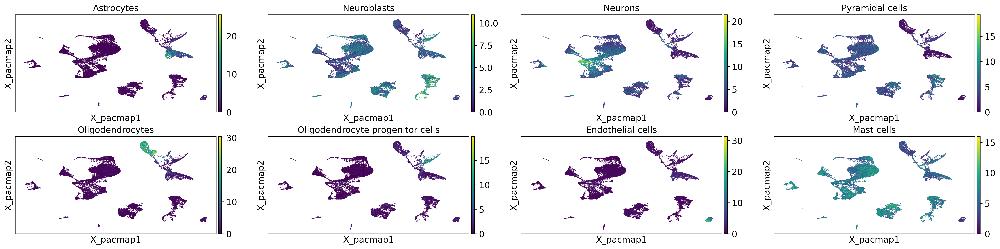

In [19]:
with rc_context({'figure.figsize': (6, 3)}):
    sc.pl.embedding(
        acts,
        basis="X_pacmap",
        color=[
            "Astrocytes",
            "Neuroblasts",
            "Neurons",
            "Pyramidal cells",
            "Oligodendrocytes",
            "Oligodendrocyte progenitor cells",
            "Endothelial cells",
            "Mast cells"
        ],
        ncols=4
        )

In [20]:
# Annotaiton
mean_enr = dc.summarize_acts(acts, groupby="leiden", min_std=1)
annotation_dict = dc.assign_groups(mean_enr)
annotation_dict

{'0': 'Mast cells',
 '1': 'Mast cells',
 '10': 'Oligodendrocytes',
 '11': 'Mast cells',
 '12': 'Oligodendrocyte progenitor cells',
 '13': 'Mast cells',
 '14': 'Neurons',
 '15': 'Mast cells',
 '16': 'Oligodendrocytes',
 '17': 'Mast cells',
 '18': 'Mast cells',
 '19': 'Bergmann glia',
 '2': 'Mast cells',
 '20': 'Endothelial cells',
 '21': 'Oligodendrocyte progenitor cells',
 '22': 'Neurons',
 '23': 'Mast cells',
 '24': 'Mast cells',
 '25': 'Mast cells',
 '26': 'Oligodendrocytes',
 '27': 'Mast cells',
 '28': 'Pyramidal cells',
 '29': 'Mast cells',
 '3': 'Mast cells',
 '30': 'Mast cells',
 '31': 'Mast cells',
 '32': 'Mast cells',
 '33': 'Mast cells',
 '34': 'Astrocytes',
 '35': 'Mast cells',
 '36': 'Oligodendrocyte progenitor cells',
 '37': 'Mast cells',
 '38': 'Neurons',
 '4': 'Astrocytes',
 '5': 'Mast cells',
 '6': 'Mast cells',
 '7': 'Mast cells',
 '8': 'Mast cells',
 '9': 'Neurons'}

In [21]:
# Add cell type column based on annotation
adata.obs["ora_celltype"] = [
    annotation_dict[str(clust)] for clust in adata.obs["leiden"]
]

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:371: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:381: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


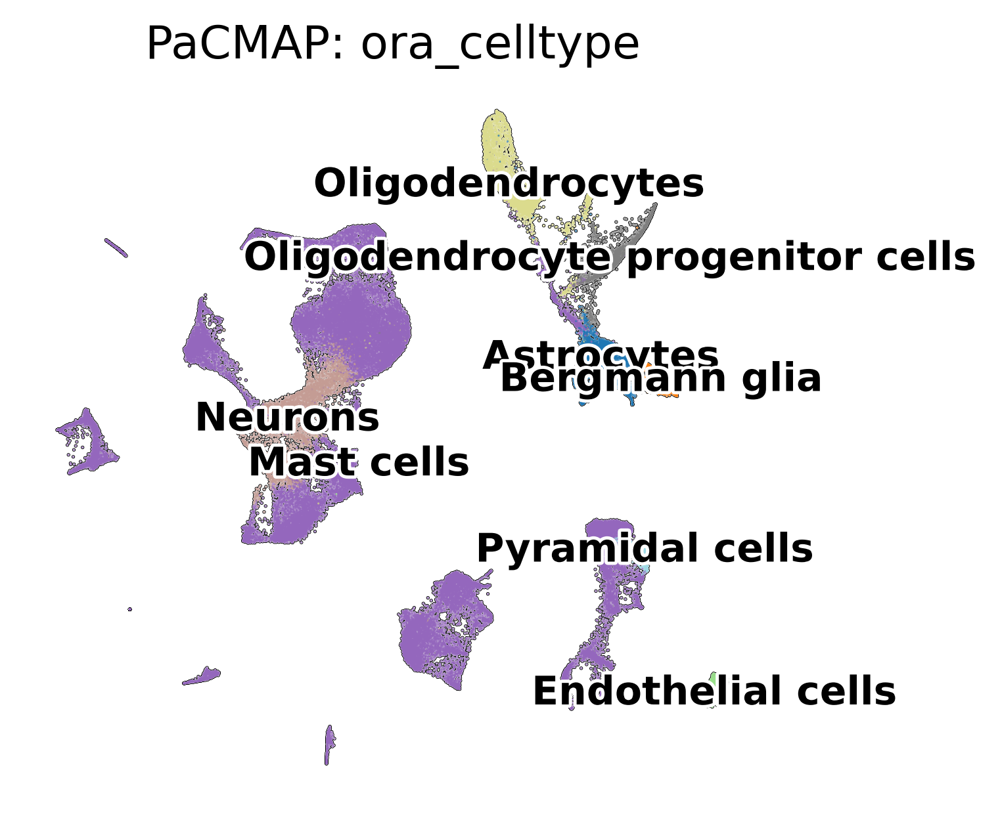

In [22]:
sc.pl.embedding(
    adata,
    basis="X_pacmap",
    color="ora_celltype",
    title="PaCMAP: {feature}".format(feature="ora_celltype"),
    add_outline=True,
    legend_loc="on data",
    legend_fontsize=12,
    legend_fontoutline=2,
    frameon=False,
    palette="tab20",
)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:371: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:381: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


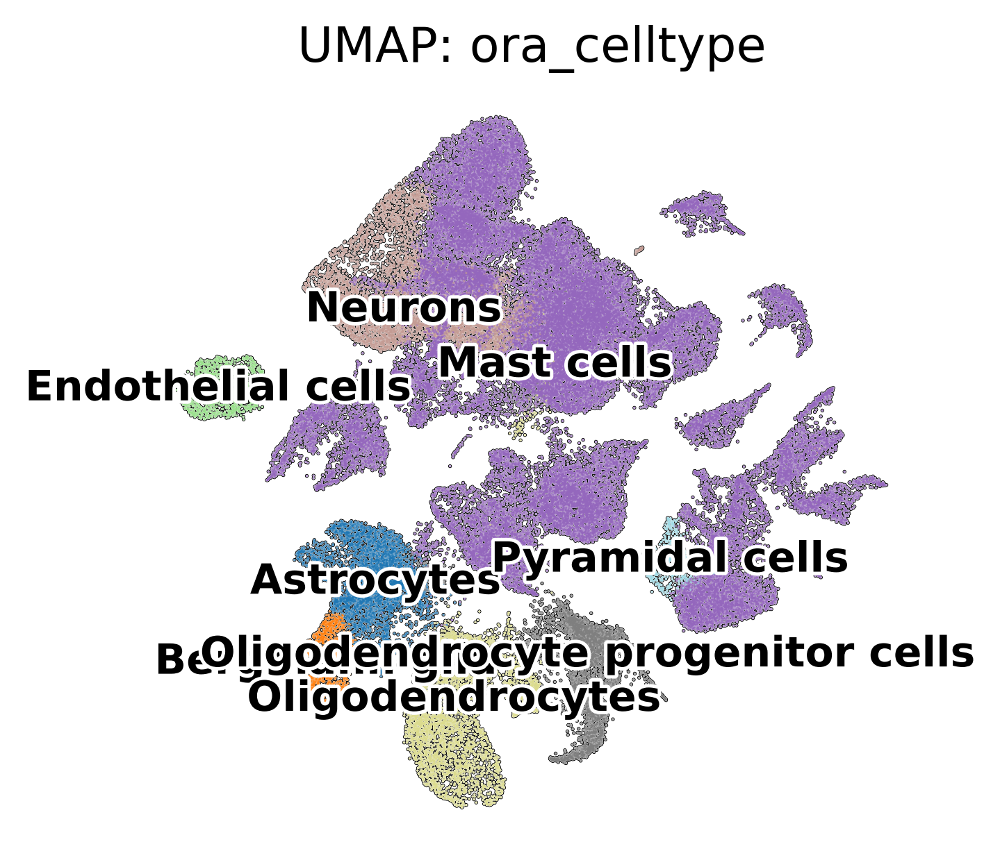

In [23]:
sc.pl.umap(
    adata,
    color="ora_celltype",
    title="UMAP: {feature}".format(feature="ora_celltype"),
    add_outline=True,
    legend_loc="on data",
    legend_fontsize=12,
    legend_fontoutline=2,
    frameon=False,
    palette="tab20",
)

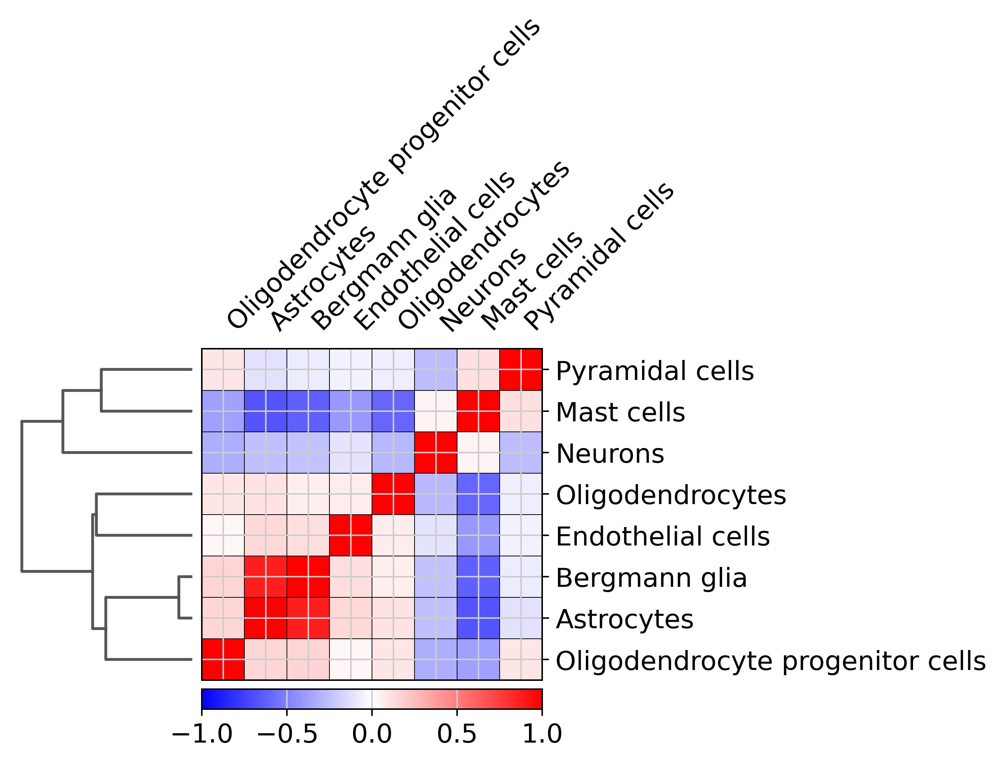

In [24]:
ax = sc.pl.correlation_matrix(adata, 'ora_celltype', figsize=(5,3.5))

In [25]:
adata.obs["sex_ora_celltype"] = pd.Categorical(adata.obs["Sex"].astype(str) + "_" + adata.obs["ora_celltype"].astype(str))

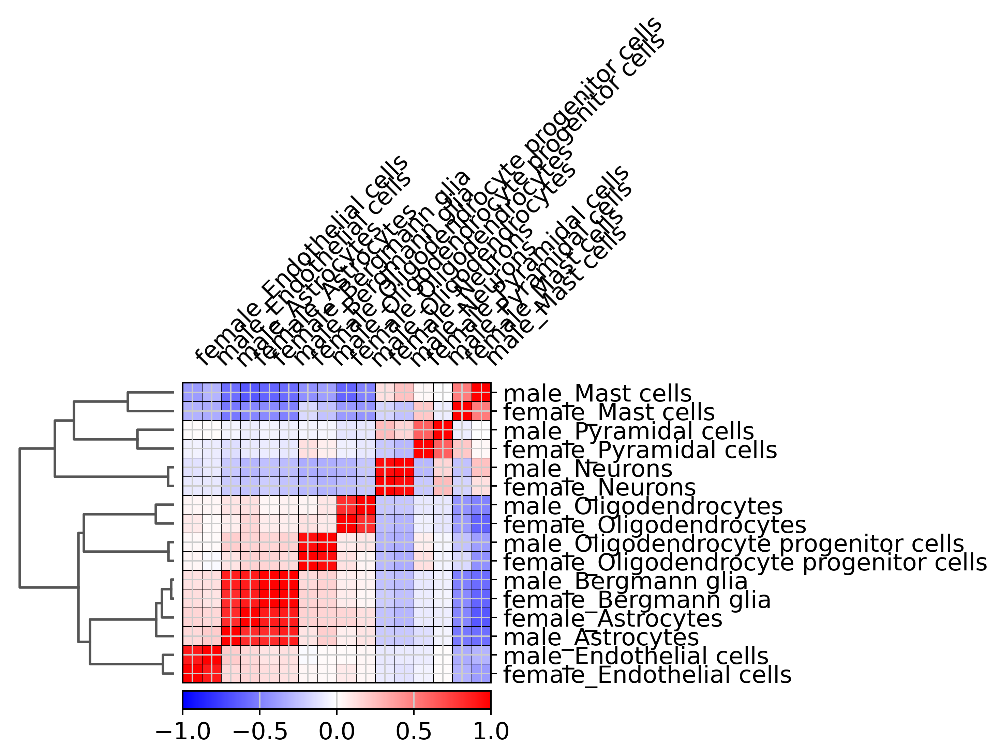

In [26]:
ax = sc.pl.correlation_matrix(adata, 'sex_ora_celltype', figsize=(5,3.5))

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


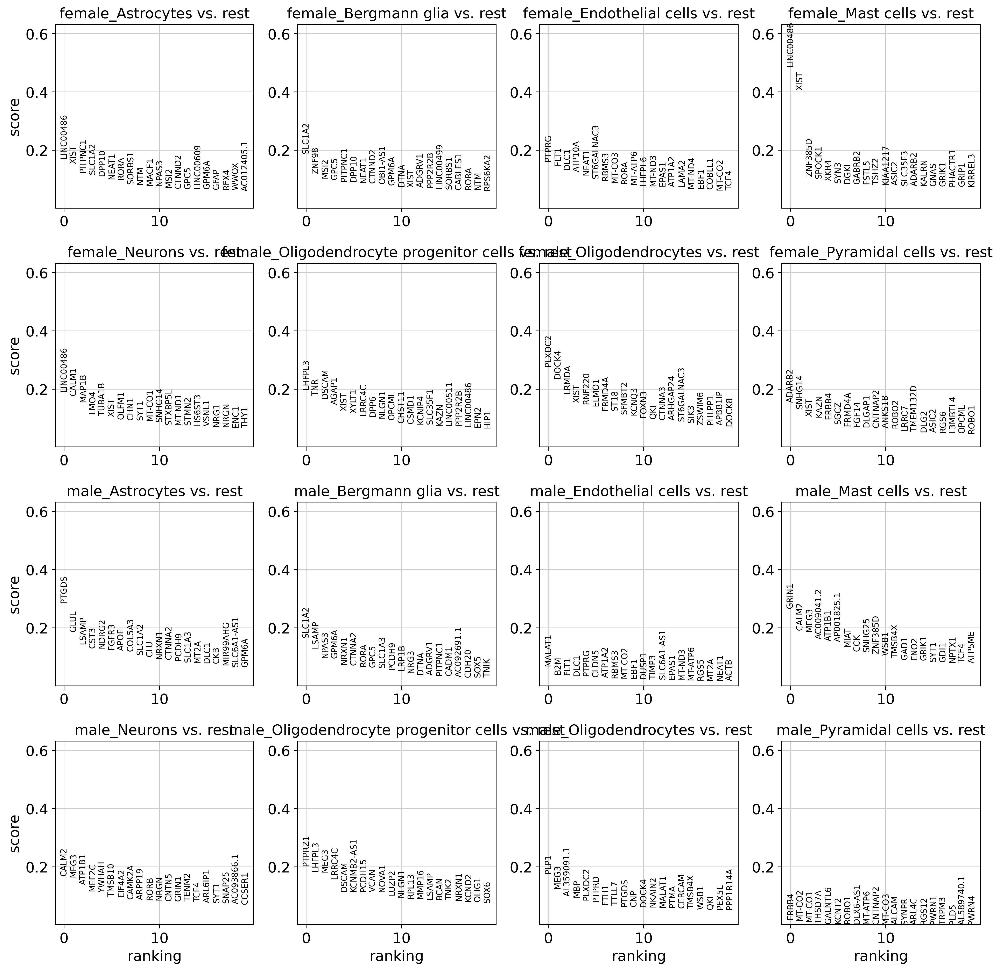

In [27]:
sc.tl.rank_genes_groups(adata, 'sex_ora_celltype', method='logreg', key_added="sex_ora_celltype")
sc.pl.rank_genes_groups(adata, key='sex_ora_celltype')


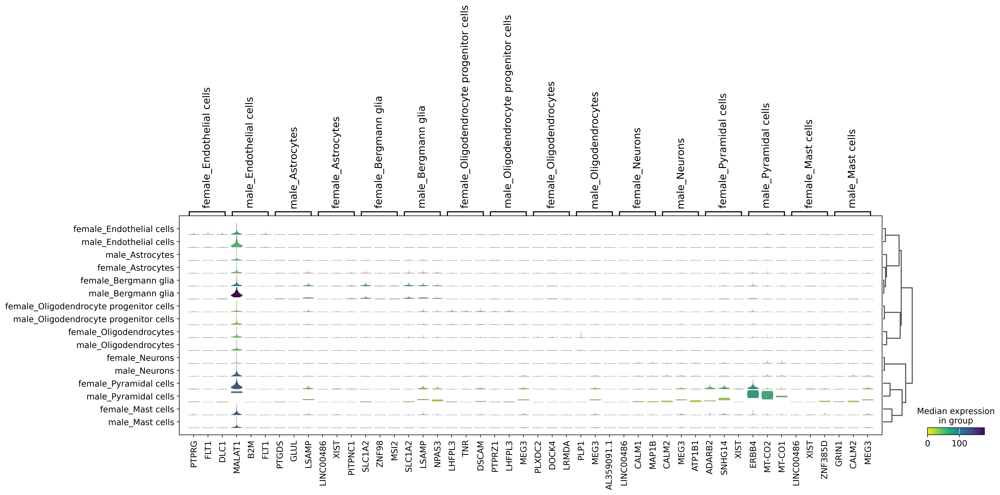

In [28]:
with rc_context({'figure.figsize': (3, 3)}):
    sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=3, cmap='viridis_r', key='sex_ora_celltype')

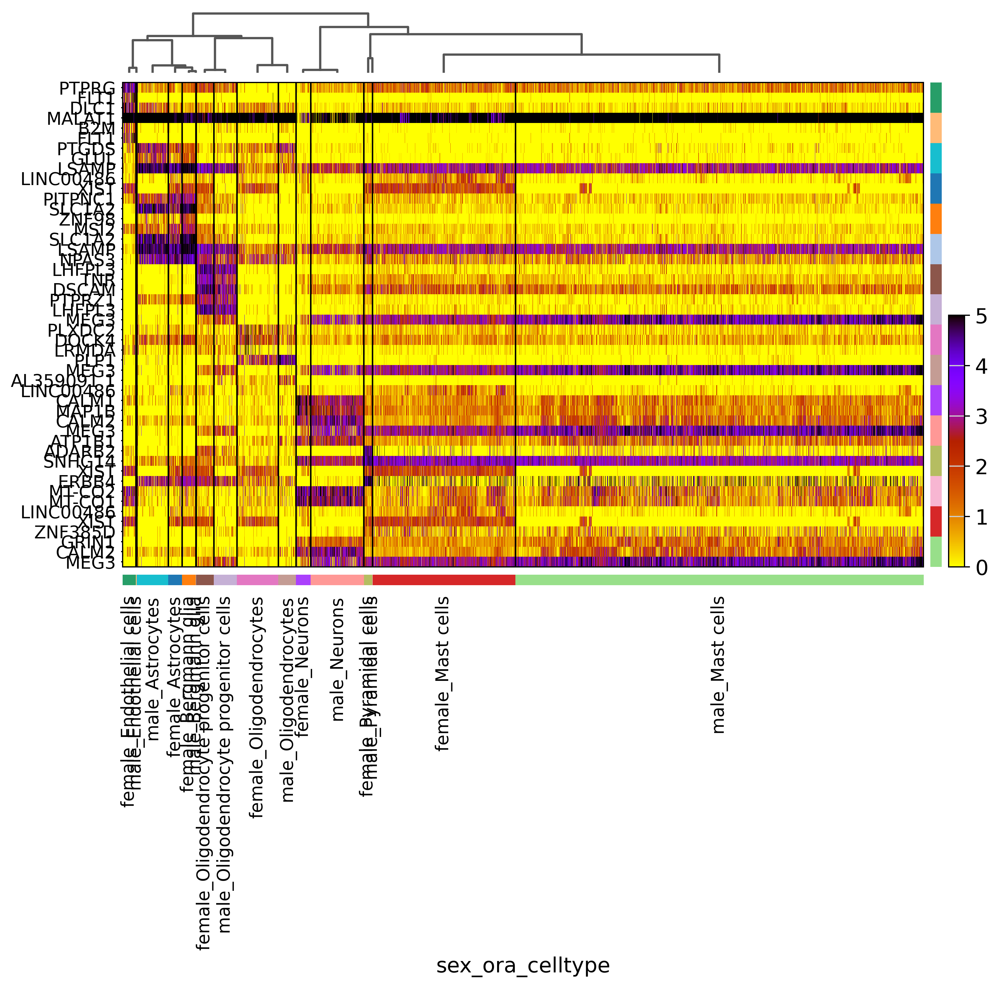

In [29]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=3, use_raw=False, swap_axes=True, vmin=0, vmax=5, cmap='gnuplot_r', layer='sqrt_norm', figsize=(10,7), show=False, key='sex_ora_celltype');


/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


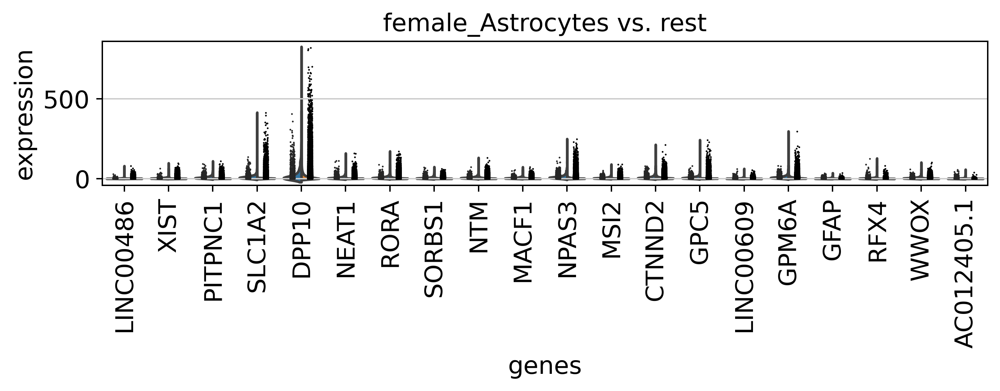

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


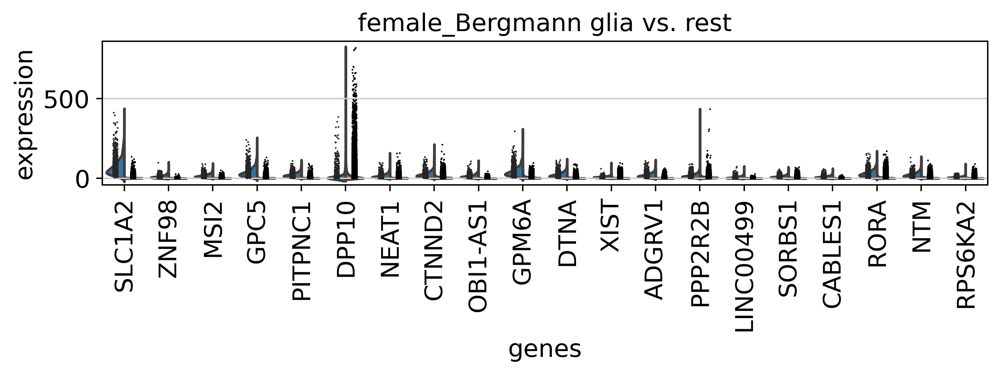

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


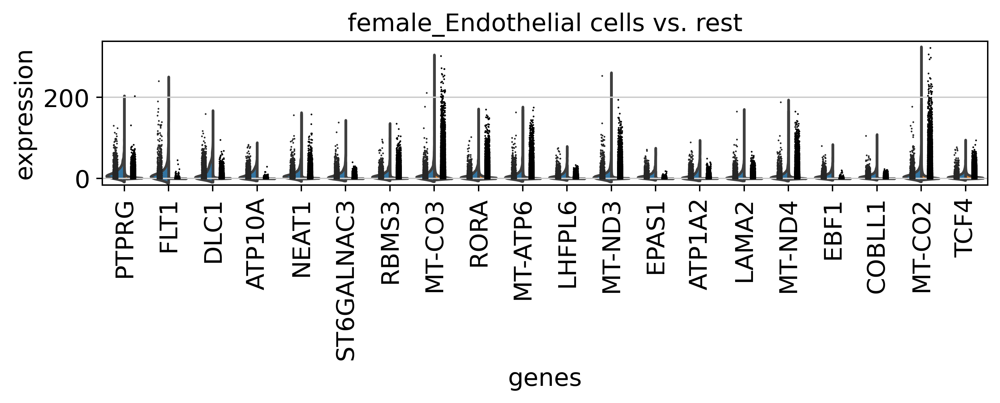

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


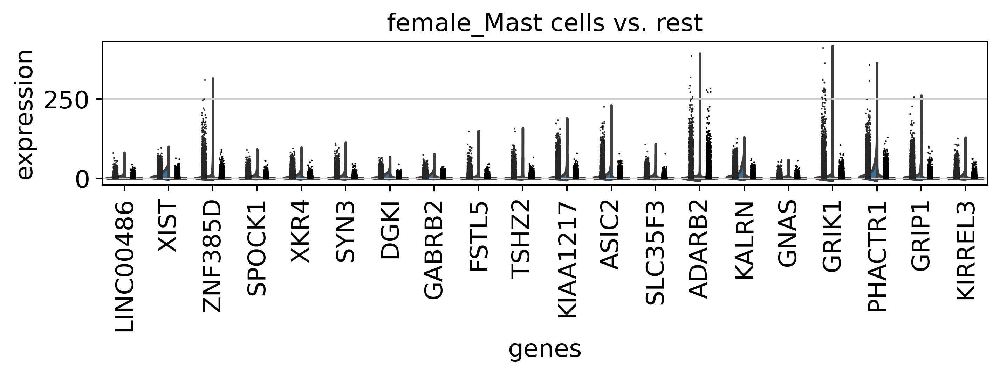

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


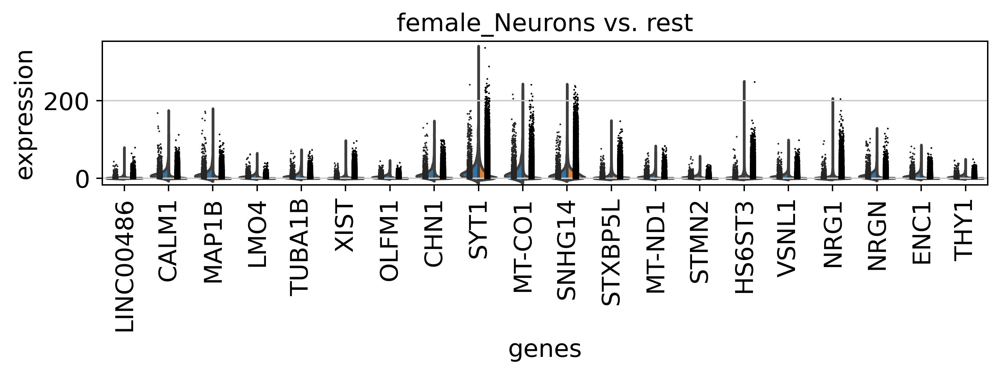

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


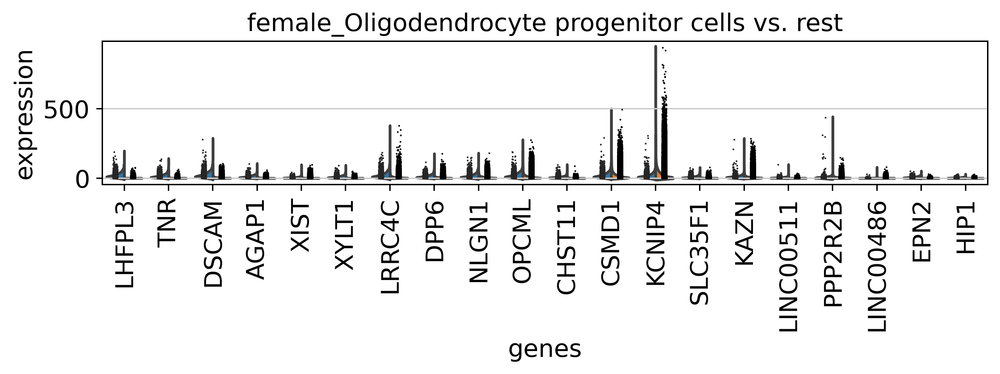

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


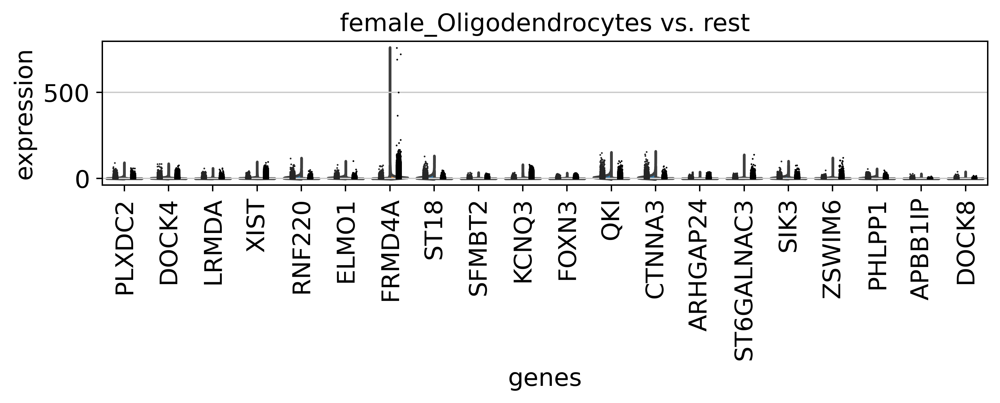

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


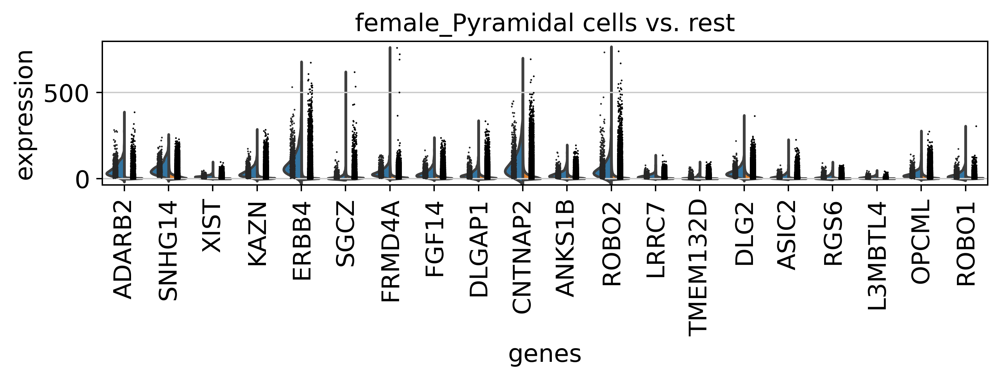

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


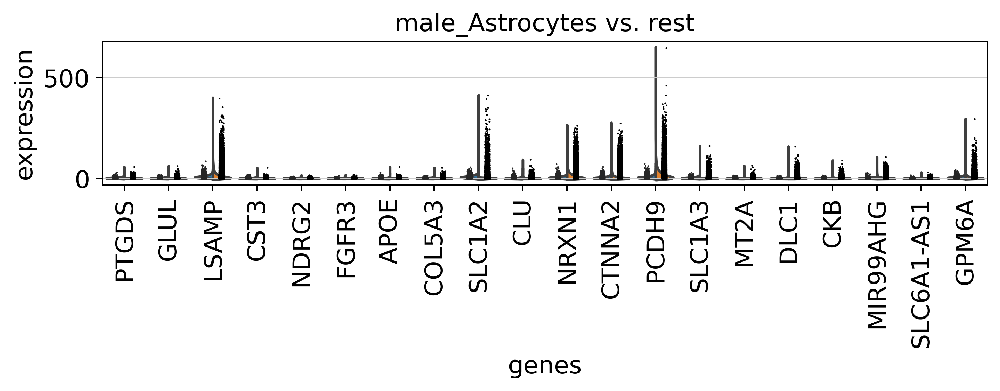

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


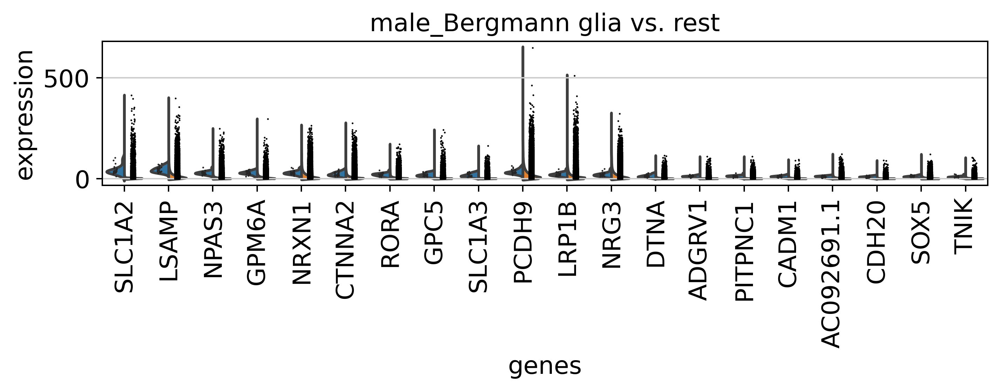

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


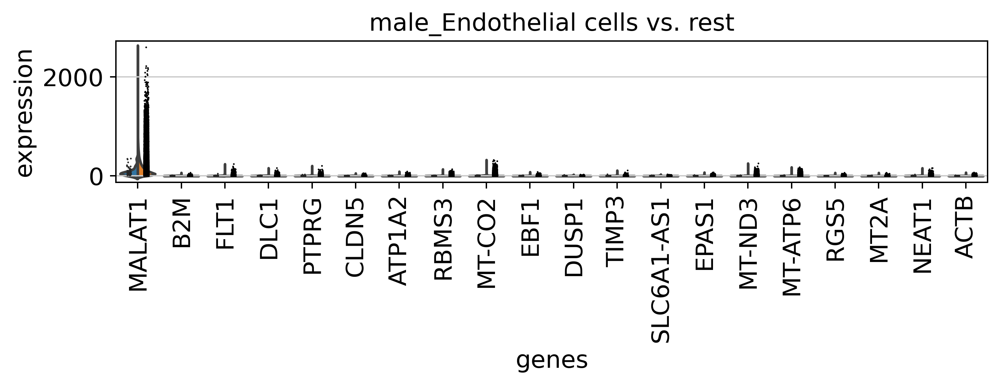

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


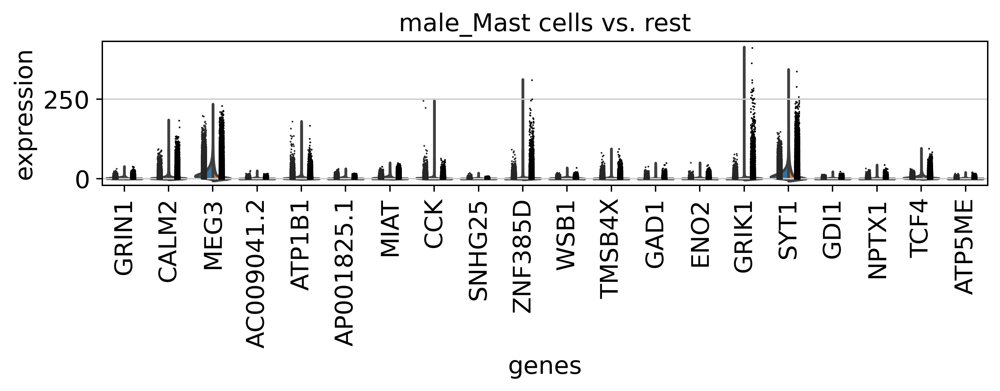

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


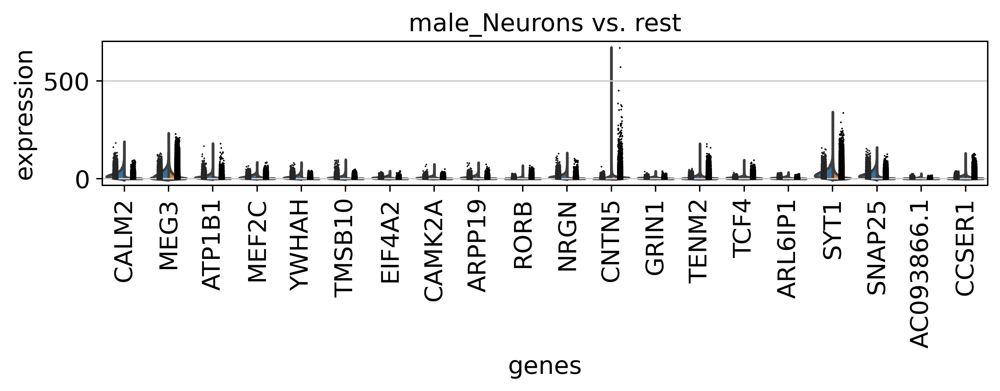

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


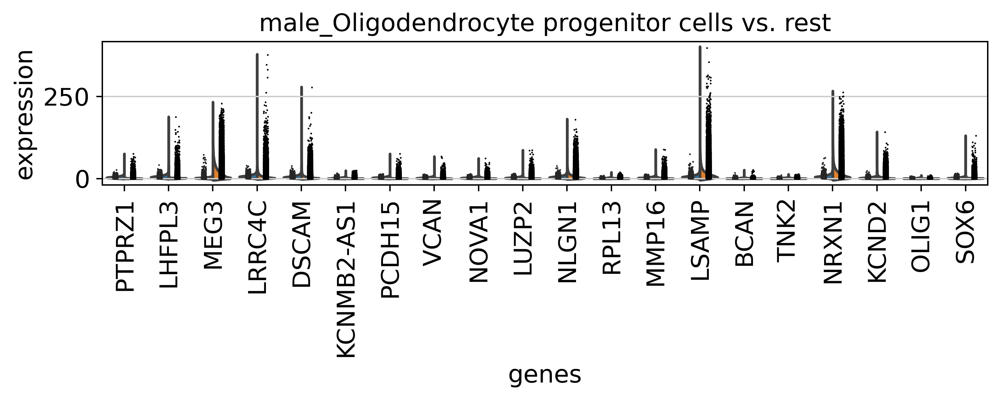

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


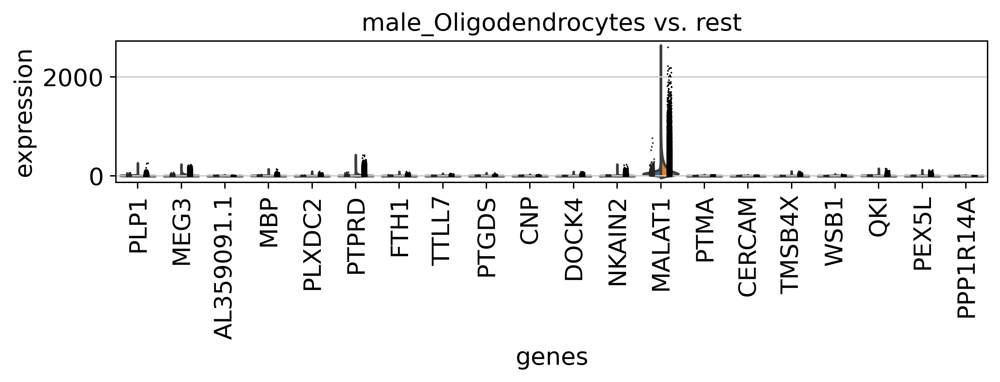

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


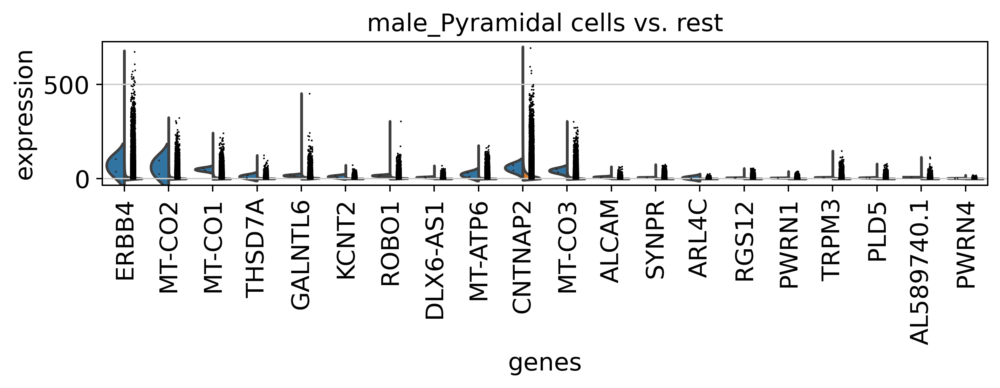

In [30]:
with rc_context({'figure.figsize': (9, 1.5)}):
    sc.pl.rank_genes_groups_violin(adata, n_genes=20, jitter=True, key='sex_ora_celltype', use_raw=False)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


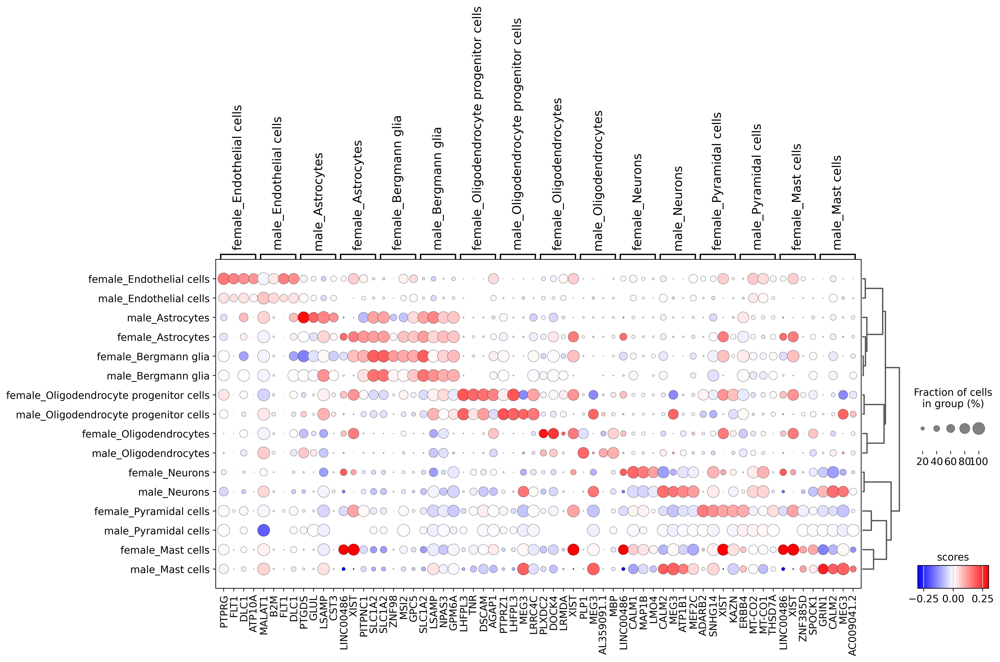

In [31]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=4, values_to_plot='scores', vmax=0.3, vmin=-0.3, cmap='bwr', key='sex_ora_celltype', figsize=(16,7))


In [32]:
adata

AnnData object with n_obs × n_vars = 75628 × 3189
    obs: 'cell_name', 'background_fraction', 'droplet_efficiency', 'doublet_score', 'nFeature_Diff', 'nCount_Diff', 'percent_mito', 'percent_ribo', 'percent_mito_ribo', 'percent_hb', 'log10GenesPerUMI', 'k_tree', 'Run', 'Condition', 'BioProject', 'Sex', 'n_genes', 'leiden', 'ora_celltype', 'sex_ora_celltype'
    var: 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable'
    uns: 'hvg', 'pca', 'pearson_residuals_normalization', 'neighbors', 'umap', 'leiden', 'ora_celltype_colors', 'dendrogram_ora_celltype', 'dendrogram_sex_ora_celltype', 'sex_ora_celltype', 'sex_ora_celltype_colors'
    obsm: 'X_pacmap', 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    layers: 'raw', 'sqrt_norm'
    obsp: 'distances', 'connectivities'

In [33]:
from sinfo import sinfo

sinfo()

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.10.3
decoupler   1.5.0
matplotlib  3.7.1
numpy       1.23.5
pacmap      0.7.1
pandas      1.5.3
scanpy      1.9.6
sinfo       0.3.4
-----
IPython             7.34.0
jupyter_client      6.1.12
jupyter_core        5.5.0
notebook            6.5.5
-----
Python 3.10.12 (main, Jun 11 2023, 05:26:28) [GCC 11.4.0]
Linux-5.15.120+-x86_64-with-glibc2.35
2 logical CPU cores, x86_64
-----
Session information updated at 2023-11-11 12:59
